# Analyzing Oligopoly Competition in Game Theory using Monte Carlo Simulation: Cournot Model

### By Ayush Majumdar

In [1]:
# importing the libraries
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import math
from scipy.stats import lognorm
from Helper import *

In [12]:
num_iterations = 10000
demand_curve_coefficient = 100
# Firms have marginal cost of production
c1 = 30
c2 = 35

## Simulation 1: Firm 1 & Firm 2 have random quantity of production 

In [3]:
df = mc_sim(
    num_iterations=num_iterations,
    demand_curve_coefficient=demand_curve_coefficient,
    c1=c1,
    c2=c2,
    q1max=101,
    q2=0,
    method='random'
)
df

,Firm 1 Quantity,Firm 2 Quantity,Firm 1 Profit,Firm 2 Profit
0,45,19,-1755,-437
1,81,1,-7533,-23
2,57,55,-5643,-5885
3,15,58,-270,-4118
4,40,47,-2280,-3478
...,...,...,...,...
9995,78,94,-14040,-19364
9996,11,52,-44,-2860
9997,23,9,345,171
9998,99,70,-19602,-12530


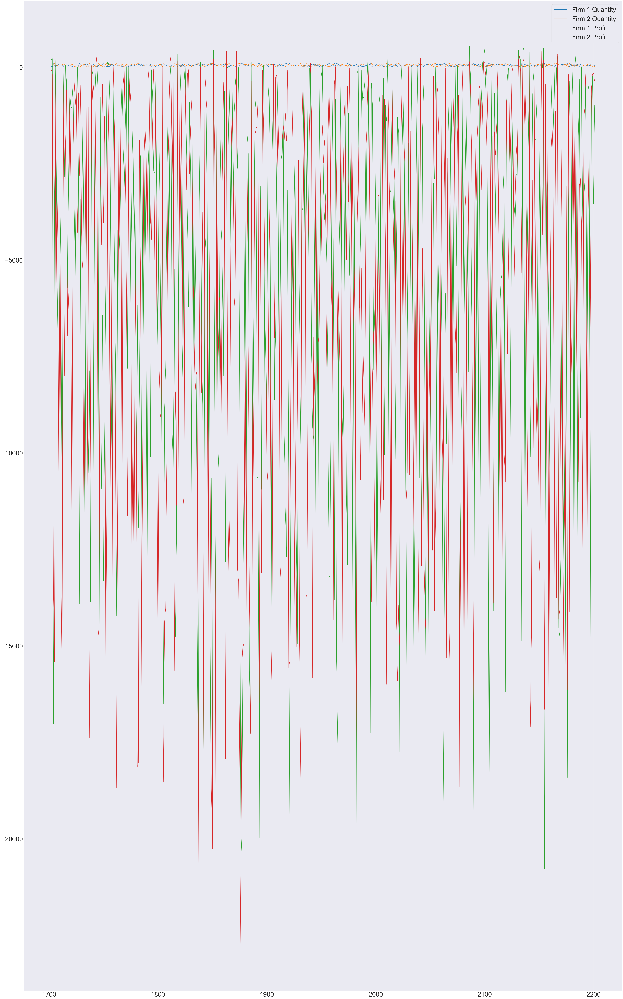

In [4]:
rand = generate_random_number(9500)
df.iloc[rand:rand+500, :].plot(figsize=(60, 100), fontsize=36)
plt.legend(fontsize=36)

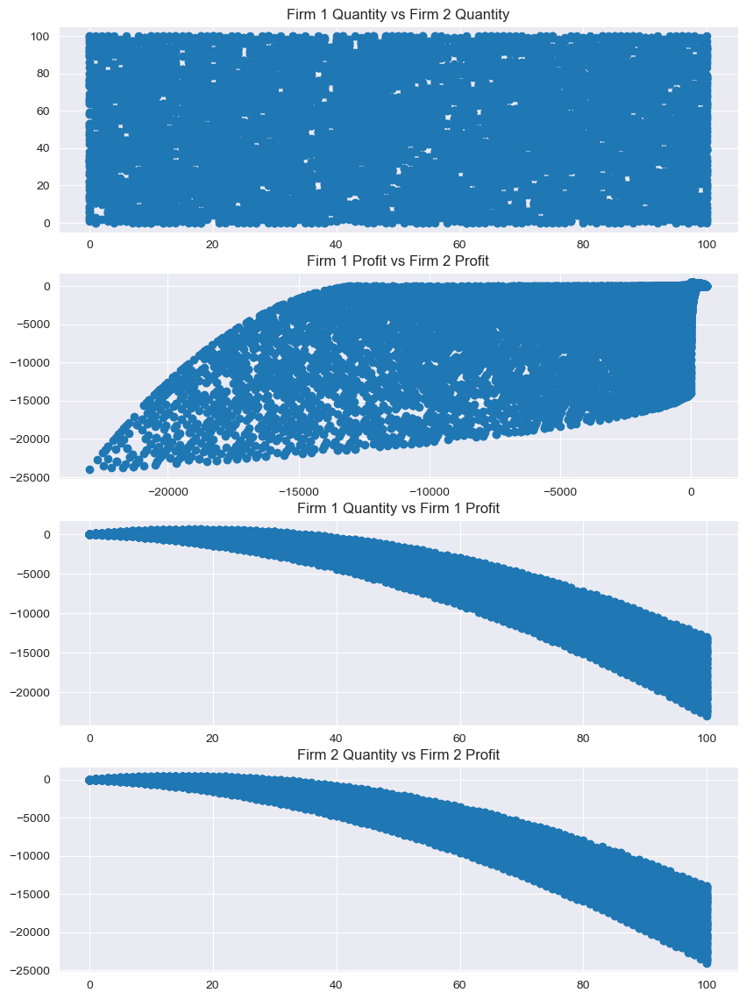

In [5]:
visualizer(df)

In [6]:
df.describe()

,Firm 1 Quantity,Firm 2 Quantity,Firm 1 Profit,Firm 2 Profit
count,10000.000000,10000.00000,10000.000000,10000.000000
mean,49.788400,50.04280,-5632.375700,-6189.259700
std,28.872308,29.07484,5658.843548,5945.346607
min,0.000000,0.00000,-23000.000000,-24000.000000
25%,25.000000,25.00000,-9504.000000,-10472.000000
50%,50.000000,50.00000,-3891.000000,-4426.000000
75%,74.000000,75.00000,-645.500000,-889.500000
max,100.000000,100.00000,612.000000,450.000000


Mean Profit for Firm 1: -5632.3757
Mean Profit for Firm 2: -6189.2597
Standard Deviation of Profit for Firm 1: 5658.843547508522
Standard Deviation of Profit for Firm 2: 5945.34660721171
***** MANN-WHITNEY U TEST *****
Mann-Whitney U statistic: 52795682.5
P-value: 7.497876342819362e-12
Reject the null hypothesis: There is a significant difference in the mean profits.


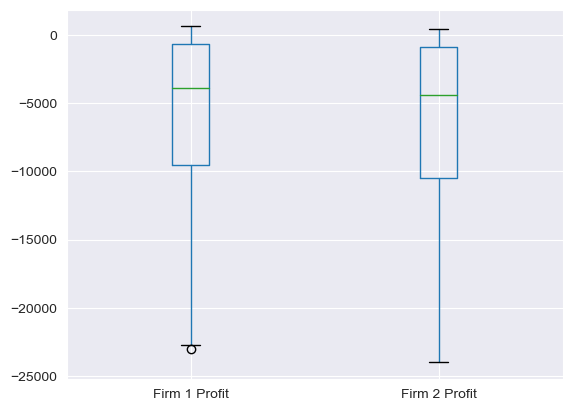

In [7]:
get_statistics(df)

In [8]:
sim1_results = get_profit(df)
print(f"Thus, out of {num_iterations} iterations, Firm 1 made a profit {sim1_results['firm1ProfitCount']/100}% of times, Firm 2 made a profit {sim1_results['firm2ProfitCount']/100}% of times, and both the firms profited simultaneously {sim1_results['bothProfitCount']/100}% of times.")

Thus, out of 10000 iterations, Firm 1 made a profit 11.62% of times, Firm 2 made a profit 8.79% of times, and both the firms profited simultaneously 6.62% of times.


## Simulation 2: Firm 1 has random quantity of production and Firm 2's quantity of production depends on Firm 1

In [9]:
f1_mean = int(df['Firm 1 Quantity'].mean())
df = mc_sim(
    num_iterations=num_iterations,
    demand_curve_coefficient=demand_curve_coefficient,
    c1=c1,
    c2=c2,
    q1max=101,
    q2=f1_mean,
    method='random'
)
df

,Firm 1 Quantity,Firm 2 Quantity,Firm 1 Profit,Firm 2 Profit
0,22,30,-88,-660
1,56,32,-4144,-1920
2,82,6,-8200,-204
3,82,20,-9348,-1240
4,55,48,-4840,-4368
...,...,...,...,...
9995,9,35,153,-665
9996,46,28,-2300,-1176
9997,1,47,21,-1645
9998,5,8,260,312


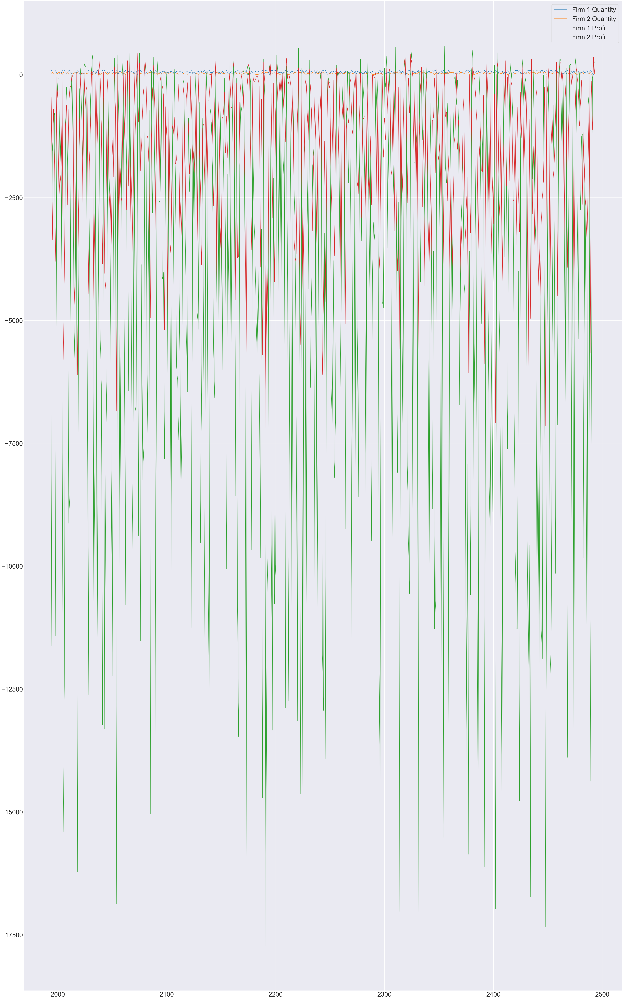

In [10]:
rand = generate_random_number(9500)
df.iloc[rand:rand+500, :].plot(figsize=(60, 100), fontsize=36)
plt.legend(fontsize=36)

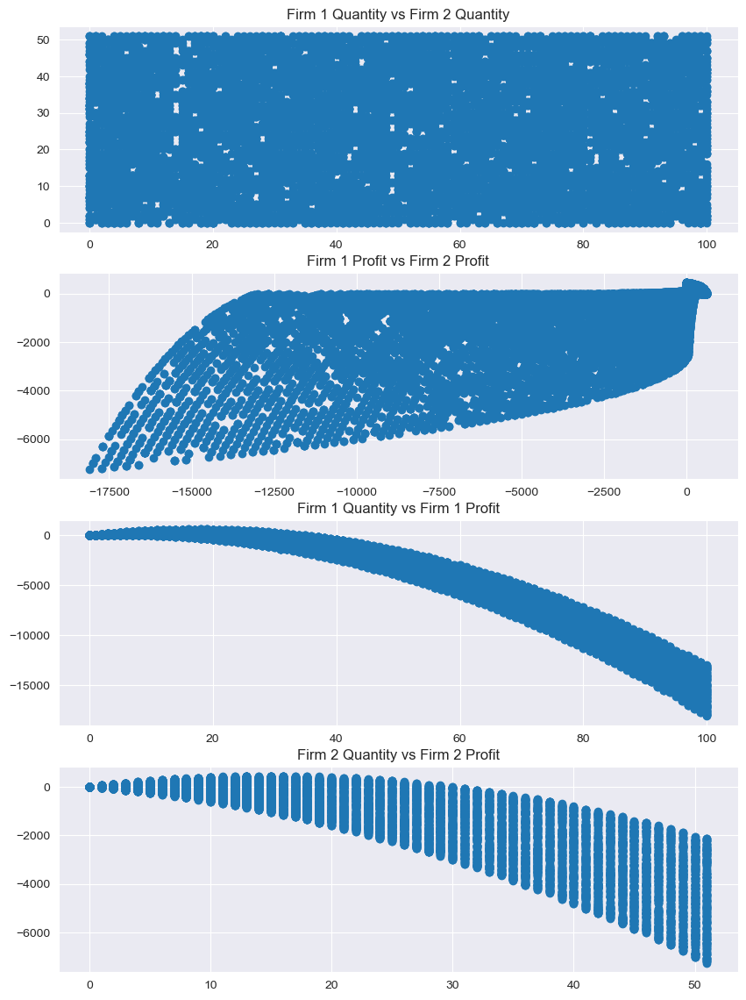

In [11]:
visualizer(df)

Mean Profit for Firm 1: -4482.1997
Mean Profit for Firm 2: -1491.7143
Standard Deviation of Profit for Firm 1: 4843.236842890461
Standard Deviation of Profit for Firm 2: 1675.0914442531703
***** MANN-WHITNEY U TEST *****
Mann-Whitney U statistic: 36179946.5
P-value: 3.4643705624076726e-251
Reject the null hypothesis: There is a significant difference in the mean profits.


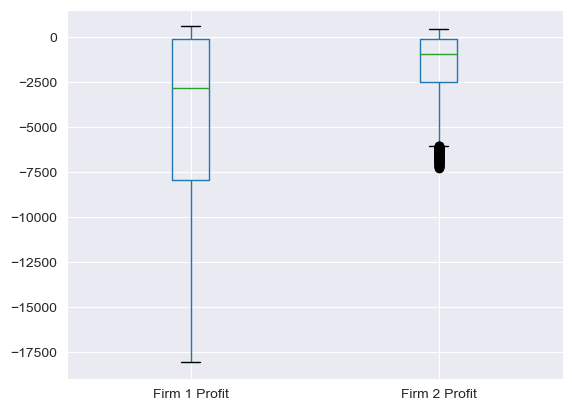

In [12]:
get_statistics(df)

In [13]:
sim2_results = get_profit(df)
print(f"Thus, out of {num_iterations} iterations, Firm 1 made a profit {sim2_results['firm1ProfitCount']/100}% of times, Firm 2 made a profit {sim2_results['firm2ProfitCount']/100}% of times, and both the firms profited simultaneously {sim2_results['bothProfitCount']/100}% of times.")

Thus, out of 10000 iterations, Firm 1 made a profit 21.17% of times, Firm 2 made a profit 16.58% of times, and both the firms profited simultaneously 12.24% of times.


## Simulation 3: Firm 1 and Firm 2 have lower costs of production

In [14]:
df = mc_sim(
    num_iterations=num_iterations,
    demand_curve_coefficient=demand_curve_coefficient,
    c1=np.random.randint(10, c1-10),
    c2=np.random.randint(10, c2-10),
    q1max=101,
    q2=0,
    method='random'
)
df

,Firm 1 Quantity,Firm 2 Quantity,Firm 1 Profit,Firm 2 Profit
0,21,66,-399,-4686
1,13,19,572,589
2,92,74,-15548,-11692
3,29,64,-957,-4800
4,13,54,117,-2106
...,...,...,...,...
9995,67,50,-6365,-4250
9996,50,41,-2600,-2050
9997,5,27,260,621
9998,66,57,-6600,-5586


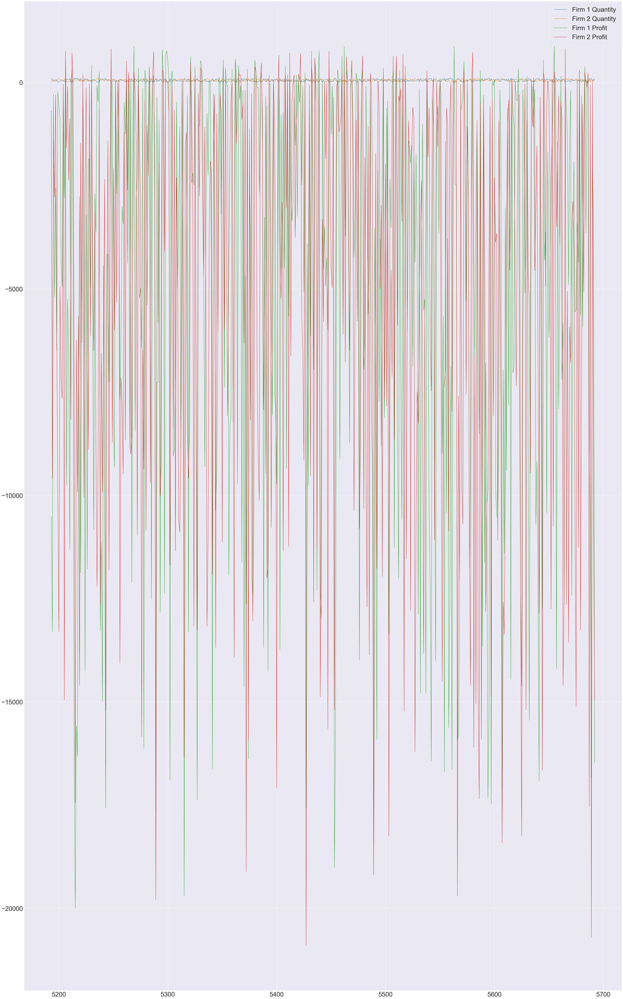

In [15]:
rand = generate_random_number(9500)
df.iloc[rand:rand+500, :].plot(figsize=(60, 100), fontsize=36)
plt.legend(fontsize=36)

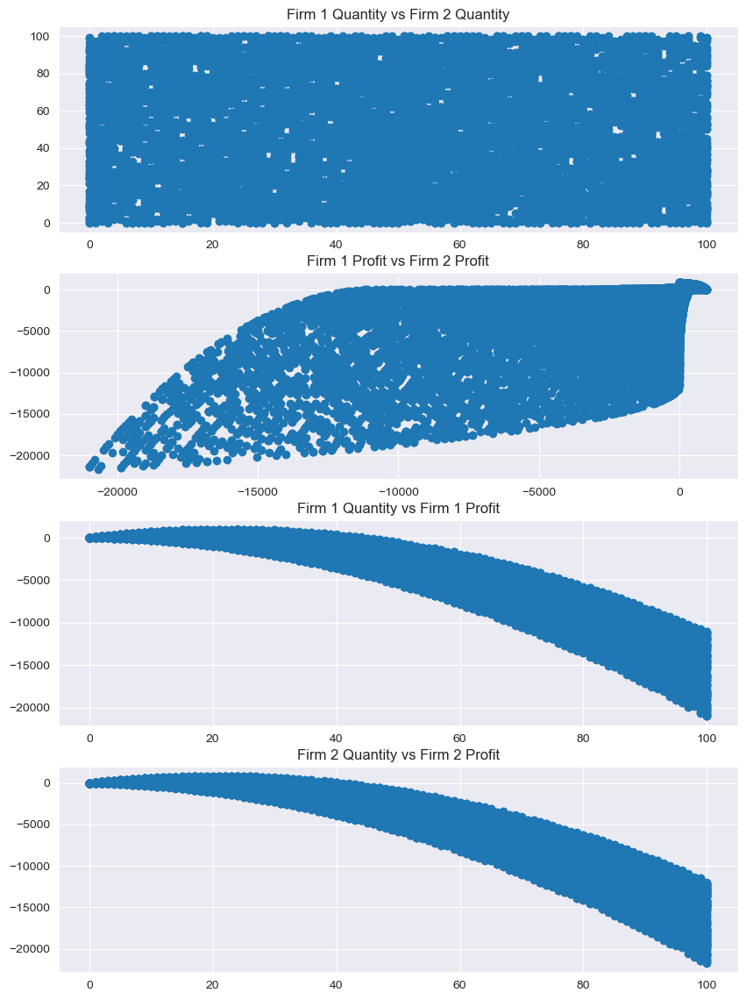

In [16]:
visualizer(df)

Mean Profit for Firm 1: -4794.4951
Mean Profit for Firm 2: -5027.9964
Standard Deviation of Profit for Firm 1: 5154.800807646468
Standard Deviation of Profit for Firm 2: 5355.434743913569
***** MANN-WHITNEY U TEST *****
Mann-Whitney U statistic: 51270838.0
P-value: 0.0018530270463287762
Reject the null hypothesis: There is a significant difference in the mean profits.


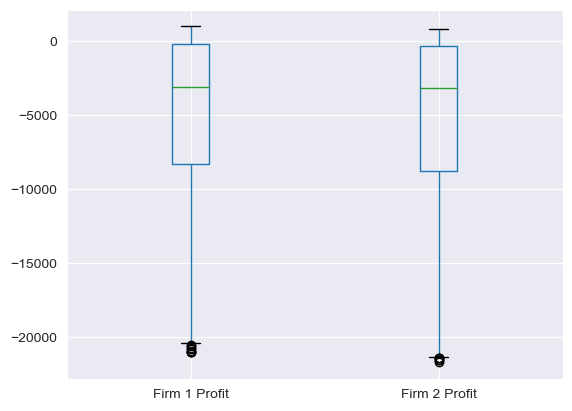

In [17]:
get_statistics(df)

In [18]:
sim3_results = get_profit(df)
print(f"Thus, out of {num_iterations} iterations, Firm 1 made a profit {sim3_results['firm1ProfitCount']/100}% of times, Firm 2 made a profit {sim3_results['firm2ProfitCount']/100}% of times, and both the firms profited simultaneously {sim3_results['bothProfitCount']/100}% of times.")

Thus, out of 10000 iterations, Firm 1 made a profit 18.28% of times, Firm 2 made a profit 15.91% of times, and both the firms profited simultaneously 11.04% of times.


## Simulation 4: Firm 2 has optimized quantity of production

In [19]:
df = mc_sim(
    num_iterations=num_iterations,
    demand_curve_coefficient=demand_curve_coefficient,
    c1=np.random.randint(10, c1),
    c2=np.random.randint(10, c2),
    q1max=101,
    q2=0,
    method='optimize'
)
df

,Firm 1 Quantity,Firm 2 Quantity,Firm 1 Profit,Firm 2 Profit
0,43,19,-645,0
1,35,23,-105,0
2,98,-9,-9506,-9
3,99,-9,-9801,0
4,45,18,-810,0
...,...,...,...,...
9995,0,40,0,40
9996,72,4,-4176,4
9997,16,32,416,32
9998,41,20,-492,0


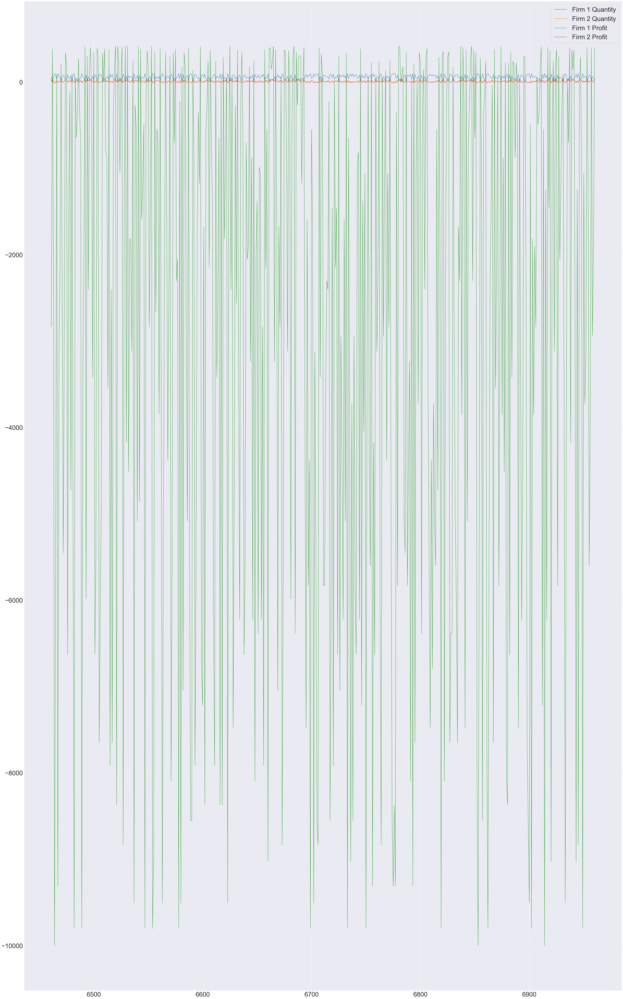

In [21]:
rand = generate_random_number(9500)
df.iloc[rand:rand+500, :].plot(figsize=(60, 100), fontsize=36)
plt.legend(fontsize=36)

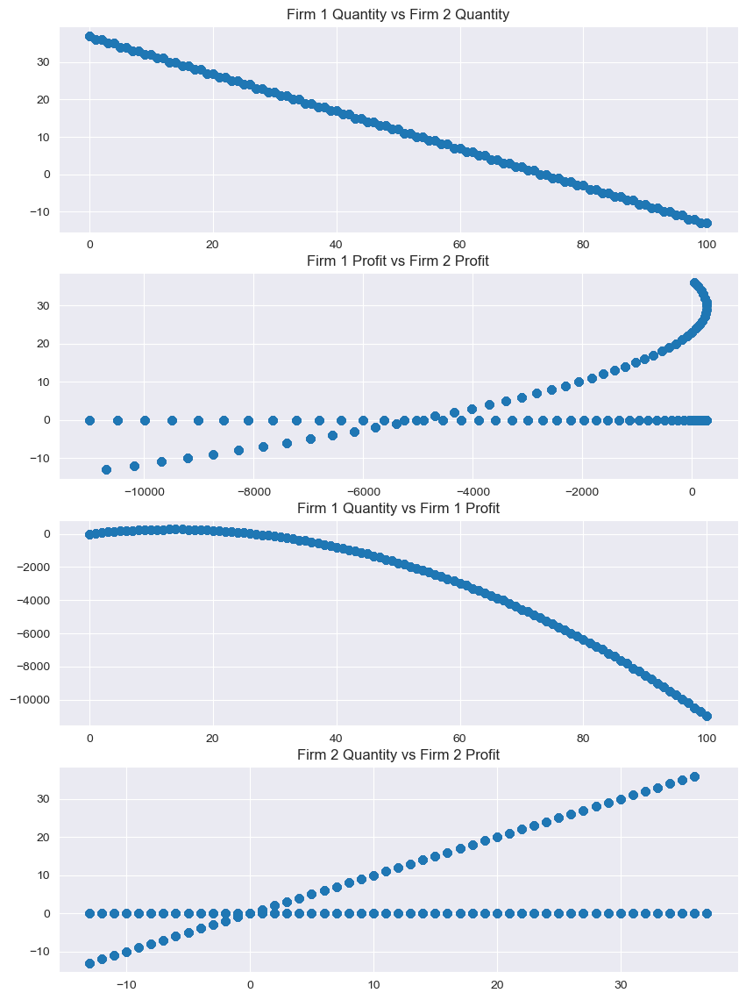

In [19]:
visualizer(df)

Mean Profit for Firm 1: -2519.8886
Mean Profit for Firm 2: 7.6917
Standard Deviation of Profit for Firm 1: 3128.23673511092
Standard Deviation of Profit for Firm 2: 12.95850467431819
***** MANN-WHITNEY U TEST *****
Mann-Whitney U statistic: 32074671.0
P-value: 0.0
Reject the null hypothesis: There is a significant difference in the mean profits.


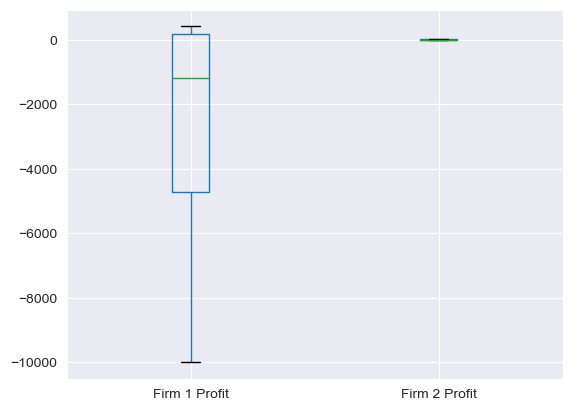

In [22]:
get_statistics(df)

In [23]:
sim4_results = get_profit(df)
print(f"Thus, out of {num_iterations} iterations, Firm 1 made a profit {sim4_results['firm1ProfitCount']/100}% of times, Firm 2 made a profit {sim4_results['firm2ProfitCount']/100}% of times, and both the firms profited simultaneously {sim4_results['bothProfitCount']/100}% of times.")

Thus, out of 10000 iterations, Firm 1 made a profit 31.26% of times, Firm 2 made a profit 40.19% of times, and both the firms profited simultaneously 15.88% of times.


## Simulation 5: Nash Equilibrium

In [16]:
df = mc_sim(
    num_iterations=num_iterations,
    demand_curve_coefficient=demand_curve_coefficient,
    c1=c1,
    c2=c2,
    method='nash'
)
df

,Firm 1 Quantity,Firm 2 Quantity,Firm 1 Profit,Firm 2 Profit
0,30,25,30,25
1,22,32,44,64
2,31,26,62,52
3,20,33,0,0
4,23,26,46,52
...,...,...,...,...
9995,32,19,0,0
9996,24,28,24,28
9997,26,21,26,21
9998,32,20,0,0


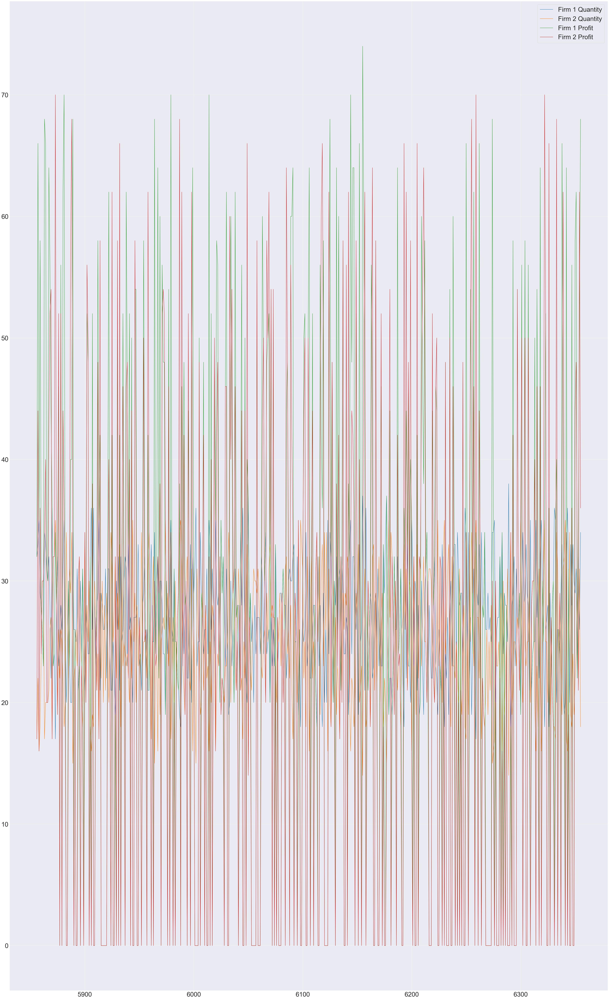

In [14]:
rand = generate_random_number(9500)
df.iloc[rand:rand+500, :].plot(figsize=(60, 100), fontsize=36)
plt.legend(fontsize=36)

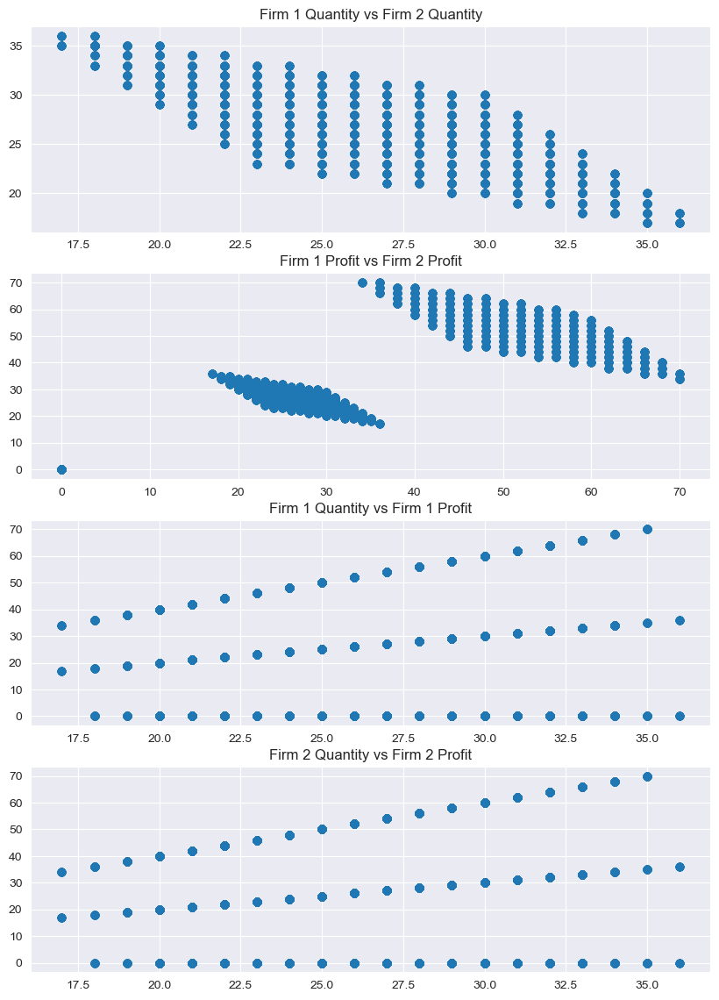

In [10]:
visualizer(df)

Mean Profit for Firm 1: 26.7329
Mean Profit for Firm 2: 24.3936
Standard Deviation of Profit for Firm 1: 22.752774038842336
Standard Deviation of Profit for Firm 2: 21.11393044522697
***** MANN-WHITNEY U TEST *****
Mann-Whitney U statistic: 52925716.0
P-value: 2.665793256292121e-13
Reject the null hypothesis: There is a significant difference in the mean profits.


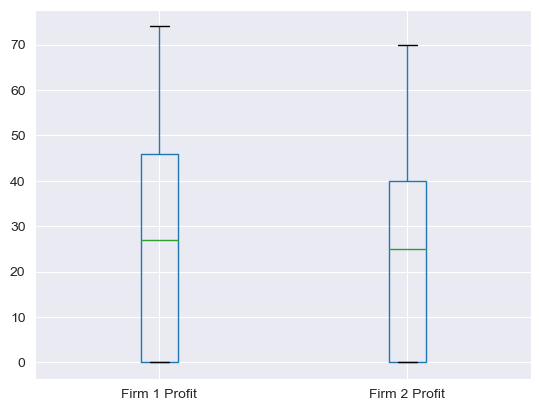

In [17]:
get_statistics(df)